In [1]:
"""installs"""

# !pip install nc-time-axis
# !pip install netCDF4 h5netcdf
# !pip install xarray
# !pip install cdsapi
# !pip install networkx geopandas osmnx igraph matplotlib


'installs'

In [2]:
# pip install pysal scikit-learn libpysal tobler geopandas numpy pandas networkx
# !pip install access


## 0. Main imports & definitions

In [3]:
import sys
from pathlib import Path

# Add parent directory to Python path to enable imports from scripts/
module_path = str(Path.cwd().parent)
if module_path not in sys.path:
    sys.path.append(module_path)

import scripts_old.model as model
import scripts_old.provision as provision


In [4]:
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize


In [5]:
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import networkx as nx
import pandas as pd
import geopandas as gpd
import os
from tqdm import tqdm

tqdm.pandas()


In [6]:
"""
winter_tr -- это должно быть зимники?
"""

KELVIN_TO_CELSIUS = 273.15

# ??????????????????
UTM_CRS = 32639
MINUTES_IN_HOUR = 60

DEMAND_COL = "demand_without"
SERVICE_NAME = "hospital"
SETTL_NAME = "mezen"
CONST_BASE_DEMAND = 120  # if not known (!)
SERVICE_RADIUS_MINUTES = 60 * 3


In [7]:
transport_modes = [
    "car_warm",
    "plane",
    "water_ship",
    "water_boat",
    "car_cold",
    "winter_tr",
]


In [8]:
main_data_path = "/Users/test/Documents/code/iccs25/initial_data/Арктика/"


## 1. Data reading & cleaning

In [9]:
settl = gpd.read_file(f"../data/processed/df_settlements_{SETTL_NAME}.geojson").to_crs(
    UTM_CRS
)
settl["name"] = settl["name"].str.replace("ё", "е")
settl.geometry = settl.geometry.buffer(1e3)


In [10]:
transport_df = (
    gpd.read_file(f"../data/processed/df_time_{SETTL_NAME}.geojson")
    .to_crs(UTM_CRS)
    .dropna(subset=["geometry"])
)
# Convert mode values from ',' to '.' and ensure they are float
for mode in transport_modes:
    transport_df[mode] = (
        transport_df[mode].astype(str).str.replace(",", ".").astype(float)
    )


In [11]:
transport_df[transport_modes] *= MINUTES_IN_HOUR  # convert from hours to minutes
transport_df[transport_modes] = transport_df[transport_modes].round(0)


In [12]:
transport_df


,edge1,edge2,car_warm,plane,water_ship,water_boat,car_cold,winter_tr,mean_time,water,winter,geometry
1,Баковская,Езевец,0.0,0.0,0.0,14.0,0.0,14.0,14,True,True,"LINESTRING (294263.984 7294853.424, 288254.846..."
3,Березник,Бор,47.0,0.0,0.0,0.0,47.0,0.0,47,False,False,"LINESTRING (196813.546 7303954.767, 222149.016..."
4,Березник,Заакакурье,49.0,0.0,0.0,0.0,49.0,0.0,49,False,False,"LINESTRING (222152.811 7275142.111, 196088.541..."
5,Березник,Заозерье,40.0,0.0,0.0,0.0,0.0,0.0,40,False,False,"LINESTRING (197602.143 7297463.953, 222147.745..."
6,Березник,Лампожня,52.0,0.0,0.0,0.0,52.0,0.0,52,False,False,"LINESTRING (222156.606 7275135.049, 193862.047..."
...,...,...,...,...,...,...,...,...,...,...,...,...
211,Черсова,Усть-Няфта,61.0,0.0,0.0,0.0,61.0,0.0,61,False,False,"LINESTRING (213113.403 7297747.286, 226221.819..."
212,Черсова,Усть-Пеза,56.0,0.0,0.0,0.0,56.0,0.0,56,False,False,"LINESTRING (226236.29 7261169.953, 208927.16 7..."
213,Чеца,Мезень,0.0,0.0,0.0,40.0,0.0,40.0,40,True,True,"LINESTRING (192058.032 7319886.866, 183969.614..."
214,Чеца,Морозилка,0.0,0.0,0.0,16.0,0.0,16.0,16,True,True,"LINESTRING (183965.516 7337368.314, 186870.515..."


In [13]:
infr_df = pd.read_csv(f"../data/raw/infrastructure_{SETTL_NAME}.csv", sep=";")
# Fill NaNs with 0
infr_df.fillna(0, inplace=True)


In [14]:
df_service = gpd.read_file(
    f"../data/processed/df_{SERVICE_NAME}_{SETTL_NAME}.geojson"
).to_crs(UTM_CRS)


# 1.1 Some visuals

In [15]:
settl.explore()


In [16]:
transport_df.explore()


In [17]:
msk1 = transport_df["car_cold"] == 0
msk2 = transport_df["car_warm"] != 0

transport_df[msk1 & msk2].explore()


In [18]:
import folium
from folium import FeatureGroup
import geopandas as gpd

transport_df = transport_df.to_crs(4326)

x = transport_df.union_all().centroid.x
y = transport_df.union_all().centroid.y


import folium
from folium import FeatureGroup
import geopandas as gpd

# Start a base map
m = folium.Map(location=[x, y], zoom_start=5, tiles="cartodbpositron", control_scale=True)

# Define transport columns you want to show as layers
transport_cols = transport_modes

# Color palette just for better visibility 
colors = ["red", "blue", "green", "purple", "orange", "black"]

# Create a layer for each transport type
for mode, color in zip(transport_cols, colors):
    fg = FeatureGroup(name=mode)
    
    # Filter edges with non-zero availability for this transport type
    gdf_filtered = transport_df[transport_df[mode] > 0]
    
    # Add each geometry as a line to the FeatureGroup
    for _, row in gdf_filtered.iterrows():
        folium.PolyLine(
            locations=[(coord[1], coord[0]) for coord in row["geometry"].coords],
            color=color,
            tooltip=f"{row['edge1']} ↔ {row['edge2']} ({mode})",
            weight=3,
        ).add_to(fg)
        
    fg.add_to(m)

# Add layer control
folium.LayerControl().add_to(m)

# Display the map
display(m)
transport_df = transport_df.to_crs(UTM_CRS)


In [19]:
import geopandas as gpd
import folium

settl = settl.to_crs(4326)
m = folium.Map(location=[x, y], zoom_start=5, tiles="cartodbpositron", control_scale=True)
# Create a FeatureGroup for settl
settl_fg = folium.FeatureGroup(name="Settlements")

# Add points as markers (or use folium.GeoJson for styling polygons)
for _, row in settl.iterrows():
    folium.CircleMarker(
        location=(row.geometry.centroid.y, row.geometry.centroid.x),
        radius=8,
        popup=transport_modes,
        color="darkgreen",
        fill=True,
        fill_opacity=0.7,
    ).add_to(settl_fg)

settl_fg.add_to(m)

# Add layer control to toggle layers
folium.LayerControl().add_to(m)

display(m)
settl = settl.to_crs(UTM_CRS)


In [20]:
df_service[df_service["capacity"] == 0].explore(column="capacity", cmap="RdYlGn")


In [21]:
transport_df.head(2)


,edge1,edge2,car_warm,plane,water_ship,water_boat,car_cold,winter_tr,mean_time,water,winter,geometry
1,Баковская,Езевец,0.0,0.0,0.0,14.0,0.0,14.0,14,True,True,"LINESTRING (294263.984 7294853.424, 288254.846..."
3,Березник,Бор,47.0,0.0,0.0,0.0,47.0,0.0,47,False,False,"LINESTRING (196813.546 7303954.767, 222149.016..."


In [22]:
settl.head(2)


,id,name,population,geometry
0,0,Азаполье,9,"POLYGON ((229755.334 7253600.456, 229750.519 7..."
1,1,Баковская,33,"POLYGON ((289251.293 7296955.283, 289246.478 7..."


# 2. Preprocessing

### 2.1 Blocks scheme creation

In [23]:
blocks_gdf = model.create_blocks(settl, const_demand=CONST_BASE_DEMAND, epsg=UTM_CRS)
blocks_gdf = model.update_blocks_with_services(
    blocks_gdf, df_service, service_type=SERVICE_NAME
)


In [24]:
blocks_gdf.head(2)


,id,name,geometry,population,epsg,capacity_hospital
0,0,Азаполье,"POLYGON ((229755.334 7253600.456, 229750.519 7...",9,32639,600
1,1,Баковская,"POLYGON ((289251.293 7296955.283, 289246.478 7...",33,32639,0


### 2.2 Graph creation

In [25]:
# Convert G to an undirected graph
G_undirected = nx.Graph()

# Add edges from transport_df
for _, row in transport_df.iterrows():
    for mode in transport_modes:
        if row[mode] != 0:
            G_undirected.add_edge(
                row["edge1"],
                row["edge2"],
                weight=round(row[mode], 2),
                label=mode,
            )

# Add node properties from blocks_gdf dataframe
for _, row in blocks_gdf.iterrows():
    node = row["name"]
    if node in G_undirected.nodes:
        for col in blocks_gdf.columns:
            # if col != "geometry":  # Skip geometry column
            G_undirected.nodes[node][col] = row[col]

            if col == "geometry":
                # Convert geometry to WKT format
                geom = row[col]
                if geom is not None:
                    G_undirected.nodes[node]["x"] = geom.centroid.x
                    G_undirected.nodes[node]["y"] = geom.centroid.y
                else:
                    G_undirected.nodes[node]["x"] = None
                    G_undirected.nodes[node]["y"] = None

G_undirected.graph["crs"] = settl.crs.to_epsg()


### 2.4 Copernicus temperature data collection

In [26]:
import glob
import zipfile

# Create folder structure for climate data
climate_data_dir = f"../data/climate_data/{SETTL_NAME}"
Path(climate_data_dir).mkdir(parents=True, exist_ok=True)

# Check if data already exists
nc_file = None
unzip_folder = os.path.join(climate_data_dir, "extracted")
if os.path.exists(unzip_folder):
    nc_files = glob.glob(os.path.join(unzip_folder, "*.nc"))
    if nc_files:
        nc_file = nc_files[0]
        print(f"Using existing NetCDF file: {nc_file}")
        climate_data = True
    else:
        climate_data = False
else:
    climate_data = False

# Only download if data doesn't exist
if not climate_data:
    print("Downloading climate data...")
    import cdsapi

    dataset = "projections-cmip6"
    request = {
        "temporal_resolution": "monthly",
        "experiment": "ssp5_8_5",
        "variable": "air_temperature",
        "level": ["1000"],
        "model": "inm_cm5_0",
        "year": [str(year) for year in range(2025, 2050, 1)],
        "month": [
            "01",
            "02",
            "03",
            "04",
            "05",
            "06",
            "07",
            "08",
            "09",
            "10",
            "11",
            "12",
        ],
        "area": [90, -180, -90, 180],  # Global area????????
    }

    client = cdsapi.Client()
    output_file = os.path.join(climate_data_dir, f"temperature_data_{SETTL_NAME}.zip")
    client.retrieve(dataset, request).download(output_file)

    # Extract downloaded data
    Path(unzip_folder).mkdir(exist_ok=True)
    with zipfile.ZipFile(output_file, "r") as zip_ref:
        zip_ref.extractall(unzip_folder)

    # Find extracted .nc file
    nc_files = glob.glob(os.path.join(unzip_folder, "*.nc"))
    if nc_files:
        nc_file = nc_files[0]
        print(f"Downloaded and extracted NetCDF file: {nc_file}")
    else:
        raise FileNotFoundError("No .nc file found in the extracted data")

# Load the data
import xarray as xr

ds = xr.open_dataset(nc_file)
print(ds)

# Save dataset metadata for reference
metadata_file = os.path.join(climate_data_dir, "metadata.txt")
with open(metadata_file, "w") as f:
    f.write(str(ds))


Using existing NetCDF file: ../data/climate_data/mezen/extracted/ta_Amon_INM-CM5-0_ssp585_r1i1p1f1_gr1_20250116-20491216.nc
<xarray.Dataset> Size: 27MB
Dimensions:    (time: 300, bnds: 2, lat: 120, lon: 180, plev: 1)
Coordinates:
  * time       (time) object 2kB 2025-01-16 12:00:00 ... 2049-12-16 12:00:00
  * plev       (plev) float64 8B 1e+05
  * lat        (lat) float64 960B -89.25 -87.75 -86.25 ... 86.25 87.75 89.25
  * lon        (lon) float64 1kB -178.0 -176.0 -174.0 ... 176.0 178.0 180.0
Dimensions without coordinates: bnds
Data variables:
    time_bnds  (time, bnds) object 5kB ...
    lat_bnds   (time, lat, bnds) float64 576kB ...
    lon_bnds   (time, lon, bnds) float64 864kB ...
    ta         (time, plev, lat, lon) float32 26MB ...
Attributes: (12/47)
    Conventions:            CF-1.7 CMIP-6.2
    activity_id:            ScenarioMIP
    branch_method:          standard
    branch_time_in_child:   60225.0
    branch_time_in_parent:  60225.0
    contact:                Evgeny 

### 2.5 Setting temperature to G

In [27]:
# def get_season_by_temperature(temp):
#     if temp < -10:
#         return "winter"
#     elif temp > 5:
#         return "summer"
#     else:
#         return "midseason"


for node in G_undirected.nodes:
    if (
        G_undirected.nodes[node]["x"] is not None
        and G_undirected.nodes[node]["y"] is not None
    ):
        lon = G_undirected.nodes[node]["x"]
        lat = G_undirected.nodes[node]["y"]

        # Extract temperature data for the node's coordinates
        city_temp = ds["ta"].sel(lat=lat, lon=lon, method="nearest") - KELVIN_TO_CELSIUS
        G_undirected.nodes[node]["temperature"] = pd.DataFrame(
            city_temp, columns=["temperature"]
        ).round(0)

        # G_undirected.nodes[node]["season"] = G_undirected.nodes[node][
        #     "temperature"
        # ].map(get_season_by_temperature)


In [28]:
from scripts.provision2 import calculate_graph_provision

# 1. Get results from new implementation
result = calculate_graph_provision(
    G_undirected,
    SERVICE_RADIUS_MINUTES,
)

result["provision_supply"] = [1 if i > 1 else i for i in result["provision_supply"]]
result["name"] = np.array(
    [data.get("name") for _, data in G_undirected.nodes(data=True)]
)
blocks_gdf = blocks_gdf.join(result.set_index("name"), on="name", rsuffix="_provision")
# result


Empty DataFrame
Columns: [origin, destination, cost]
Index: []
      origin  destination   cost origin_name destination_name
0          1            1    0.0   Баковская        Баковская
1          1            7   14.0   Баковская           Езевец
2          1            2  145.0   Баковская         Березник
3          1            3  122.0   Баковская              Бор
4          1           11  124.0   Баковская       Заакакурье
...      ...          ...    ...         ...              ...
1595      46           33   84.0     Чижгора           Печище
1596      46           24    inf     Чижгора            Мегра
1597      46            8    inf     Чижгора           Елкино
1598      46           45    inf     Чижгора             Чеца
1599      46           46    0.0     Чижгора          Чижгора

[1600 rows x 5 columns]


In [29]:
blocks_gdf


,id,name,geometry,population,epsg,capacity_hospital,provision_supply
0,0,Азаполье,"POLYGON ((229755.334 7253600.456, 229750.519 7...",9,32639,600,NaN
1,1,Баковская,"POLYGON ((289251.293 7296955.283, 289246.478 7...",33,32639,0,1.000000
2,2,Березник,"POLYGON ((223155.568 7275140.71, 223150.752 72...",134,32639,600,1.000000
3,3,Бор,"POLYGON ((197813.422 7303955.333, 197808.607 7...",120,32639,0,1.000000
4,4,Бычье,"POLYGON ((229179.949 7309507.448, 229175.134 7...",146,32639,600,1.000000
5,5,Долгощелье,"POLYGON ((159938.512 7345009.51, 159933.696 73...",623,32639,600,1.000000
6,6,Дорогорское,"POLYGON ((201893.434 7291139.811, 201888.619 7...",349,32639,600,1.000000
7,7,Езевец,"POLYGON ((295266.132 7294855.028, 295261.317 7...",32,32639,600,1.000000
8,8,Елкино,"POLYGON ((342709.941 7289500.921, 342705.126 7...",26,32639,600,1.000000
9,9,Жердь,"POLYGON ((210446.496 7286738.661, 210441.681 7...",107,32639,1200,0.970685


In [30]:
# 5. Visualize results on map (using existing visualization code)
blocks_gdf.to_crs(UTM_CRS).explore(
    column="provision_supply",
    cmap="RdYlGn",
    legend=True,
    tooltip=["provision_supply"],
    name="Provision",
    style_kwds={"fillOpacity": 0.7},
)


# 4. Ok so to the modelling again...

### Для третьего года (2035) плохие показатели это ок согласно картинкам ниже с графиком изменения температур(ы)

In [31]:
import networkx as nx
import pandas as pd
import numpy as np


class Statistics:
    def __init__(self):
        self.records = pd.DataFrame(
            columns=[
                "idx",
                "metric",
            ]
        )
        self.graphs = list()
        self.results = list()

    def add_record(self, step_index, metrics: dict, G, result):
        new_row = pd.DataFrame(
            [
                {
                    "idx": step_index,
                    "metric": metrics.get("metric"),
                }
            ]
        )
        self.records = pd.concat([self.records, new_row], ignore_index=True)
        self.graphs.append(G)
        self.results.append(result)

    def summary(self):
        return self.records.pivot_table(index="idx", columns="col", values="metric")

    def full(self):
        return self.records


def sigmoid(x, center, steepness=1):
    """
    Sigmoid function for smooth probability transition
    center: temperature at which probability is 0.5
    steepness: controls how sharp the transition is
    """
    return 1 / (1 + np.exp(-steepness * (x - center)))


def get_transport_probability(transport_type, temperature):
    """
    Calculate transport probability based on temperature using smooth transitions
    """
    if transport_type == "plane":
        # Planes work better in warmer weather, degrading below -10°C
        return np.round(sigmoid(temperature, -5, 0.5), 5)

    elif transport_type in ["water_boat", "water_ship"]:
        # Water transport needs above-freezing temperatures
        return np.round(sigmoid(temperature, 0, 0.8), 5)

    elif transport_type == "car_warm":
        # Regular cars work better in warm weather
        return np.round(sigmoid(temperature, 7, 0.7), 5)

    elif transport_type in ["car_cold", "winter_tr"]:
        # Winter transport works better in cold weather
        return 1 - np.round(sigmoid(temperature, 5, 0.4), 5)

    return -1e6


class AgglomerationNetwork:
    def __init__(self, graph, threshold):
        self.original_graph = graph.copy()
        self.graph = graph.copy()
        self.threshold = threshold
        self.stats = Statistics()
        self.current_step = 0  # Initialize current_step

    def _get_edge_temperature(self, G, u, v, idx):
        """
        RULE: Minimum temperature of the two nodes
        """

        season_u = G.nodes[u].get("temperature").loc[idx].item()
        season_v = G.nodes[v].get("temperature").loc[idx].item()

        # сравниваем по приоритету
        return np.round(np.mean([season_u, season_v]), 1)

    def assign_edge_temperatures(self, G, idx):
        for u, v in G.edges:
            G.edges[u, v]["temperature"] = self._get_edge_temperature(G, u, v, idx)

        return G

    def assign_transport_probabilities(self, G):
        """
        Assigns smooth transport probabilities based on temperature
        """
        for _, _, data in G.edges(data=True):
            transport_type = data.get("label")
            temperature = data.get("temperature")
            if transport_type and temperature:
                data["transport_probability"] = get_transport_probability(
                    transport_type, temperature
                )
            else:
                data["transport_probability"] = -1e3

    def filter_edges_by_probability(self, G, threshold):
        """
        Возвращает копию графа G, содержащую только те рёбра,
        у которых transport_probability >= threshold
        """
        G_filtered = nx.Graph()
        G_filtered.add_nodes_from(G.nodes(data=True))

        for u, v, data in G.edges(data=True):
            # print(f"edge: {u} - {v}, data: {data}")
            prob = data.get("transport_probability", 0.0)
            if prob >= threshold:
                G_filtered.add_edge(u, v, **data)
        G_filtered.graph["crs"] = G.graph["crs"]
        return G_filtered

    def analyze_node_connectivity(self, G, node_id):
        """
        Analyze connectivity for a specific node in the graph

        Args:
            G: NetworkX graph
            node_id: ID of the node to analyze

        Returns:
            Dictionary containing connected and unconnected nodes
        """
        # Get all nodes in graph
        all_nodes = set(G.nodes())

        # Get connected nodes (neighbors)
        connected_nodes = set(G.neighbors(node_id))

        # Get unconnected nodes
        unconnected_nodes = all_nodes - connected_nodes - {node_id}

        # Get edge information for connected nodes
        edge_info = {}
        for neighbor in connected_nodes:
            edge_info[neighbor] = G[node_id][neighbor]

        return {
            "node_id": node_id,
            "node_name": G.nodes[node_id].get("name", "N/A"),
            "total_nodes": len(all_nodes),
            "connected_nodes": {
                "count": len(connected_nodes),
                "nodes": connected_nodes,
                "edge_info": edge_info,
            },
            "unconnected_nodes": {
                "count": len(unconnected_nodes),
                "nodes": unconnected_nodes,
            },
        }

    def run_all_steps(self, idx):
        self.current_step = idx  # Update current_step
        self.assign_edge_temperatures(self.graph, idx)
        self.assign_transport_probabilities(self.graph)
        G_filtered = self.filter_edges_by_probability(
            self.graph, threshold=self.threshold
        )

        G, result, A = provision.calculate_graph_provision(
            G_filtered,
            SERVICE_RADIUS_MINUTES,
            CONST_BASE_DEMAND,
            service_name=SERVICE_NAME,
            return_assignment=True,
        )

        display(result)

        avg_provision = result["provision"].mean().round(2)

        other_metrics = {
            "metric": avg_provision,
        }
        metrics = {**other_metrics}

        self.stats.add_record(step_index=idx, metrics=metrics, G=G, result=result)


threshold = 0.3
net = AgglomerationNetwork(graph=G_undirected, threshold=threshold)

range_year = range(list(G_undirected.nodes(data=True))[0][1]["temperature"].shape[0])

for idx in tqdm(range_year):
    net.run_all_steps(idx)

df_stats = net.stats.records
# df_stats.groupby(df_stats.index // 12).mean().iloc[:, -1].round(2)


  0%|          | 0/300 [00:00<?, ?it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  0%|          | 1/300 [00:00<00:55,  5.36it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  1%|          | 2/300 [00:00<00:45,  6.54it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  1%|          | 3/300 [00:00<00:42,  6.93it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  1%|▏         | 4/300 [00:00<00:40,  7.38it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  2%|▏         | 5/300 [00:00<01:01,  4.77it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  2%|▏         | 6/300 [00:01<00:55,  5.29it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  2%|▏         | 7/300 [00:01<00:49,  5.93it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  3%|▎         | 8/300 [00:01<00:52,  5.52it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  3%|▎         | 9/300 [00:01<00:47,  6.17it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  3%|▎         | 10/300 [00:01<00:41,  6.98it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  4%|▎         | 11/300 [00:01<00:44,  6.45it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  4%|▍         | 12/300 [00:01<00:39,  7.21it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  4%|▍         | 13/300 [00:02<00:36,  7.81it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  5%|▍         | 14/300 [00:02<00:41,  6.86it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  5%|▌         | 15/300 [00:02<00:58,  4.89it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  5%|▌         | 16/300 [00:02<00:52,  5.45it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  6%|▌         | 17/300 [00:02<00:54,  5.16it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  6%|▌         | 18/300 [00:03<00:54,  5.21it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  6%|▋         | 19/300 [00:03<00:46,  5.99it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  7%|▋         | 20/300 [00:03<00:47,  5.88it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  7%|▋         | 21/300 [00:03<00:50,  5.50it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  7%|▋         | 22/300 [00:03<00:44,  6.29it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  8%|▊         | 23/300 [00:03<00:44,  6.21it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  8%|▊         | 25/300 [00:04<00:38,  7.23it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  9%|▊         | 26/300 [00:04<00:38,  7.17it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


  9%|▉         | 27/300 [00:04<00:40,  6.73it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 10%|▉         | 29/300 [00:04<00:39,  6.83it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 10%|█         | 30/300 [00:04<00:37,  7.15it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 10%|█         | 31/300 [00:04<00:40,  6.70it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 11%|█         | 32/300 [00:05<00:42,  6.29it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 11%|█         | 33/300 [00:05<00:39,  6.79it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 12%|█▏        | 35/300 [00:05<00:37,  7.16it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 12%|█▏        | 36/300 [00:05<00:34,  7.66it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 12%|█▏        | 37/300 [00:05<00:32,  8.12it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 13%|█▎        | 38/300 [00:05<00:35,  7.42it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 13%|█▎        | 39/300 [00:06<00:46,  5.66it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 13%|█▎        | 40/300 [00:06<00:40,  6.45it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 14%|█▎        | 41/300 [00:06<00:37,  6.99it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 14%|█▍        | 42/300 [00:06<00:34,  7.40it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 15%|█▍        | 44/300 [00:06<00:34,  7.46it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 15%|█▌        | 45/300 [00:06<00:32,  7.74it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 15%|█▌        | 46/300 [00:06<00:30,  8.20it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 16%|█▌        | 47/300 [00:07<00:29,  8.61it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 16%|█▌        | 48/300 [00:07<00:33,  7.51it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 16%|█▋        | 49/300 [00:07<00:31,  8.05it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 17%|█▋        | 50/300 [00:07<00:29,  8.46it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 17%|█▋        | 51/300 [00:07<00:33,  7.41it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 17%|█▋        | 52/300 [00:07<00:30,  8.01it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 18%|█▊        | 53/300 [00:07<00:33,  7.27it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 18%|█▊        | 54/300 [00:08<00:32,  7.61it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 18%|█▊        | 55/300 [00:08<00:31,  7.87it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 19%|█▊        | 56/300 [00:08<00:35,  6.89it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 19%|█▉        | 57/300 [00:08<00:33,  7.35it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 19%|█▉        | 58/300 [00:08<00:34,  6.97it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 20%|█▉        | 59/300 [00:08<00:31,  7.64it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 20%|██        | 60/300 [00:08<00:30,  7.93it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 20%|██        | 61/300 [00:08<00:32,  7.34it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 21%|██        | 62/300 [00:09<00:29,  7.94it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 21%|██        | 63/300 [00:09<00:33,  7.01it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 21%|██▏       | 64/300 [00:09<00:30,  7.68it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 22%|██▏       | 65/300 [00:09<00:33,  7.01it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 22%|██▏       | 66/300 [00:09<00:31,  7.45it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 23%|██▎       | 68/300 [00:09<00:30,  7.63it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 23%|██▎       | 69/300 [00:10<00:28,  8.11it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 23%|██▎       | 70/300 [00:10<00:31,  7.35it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 24%|██▎       | 71/300 [00:10<00:32,  6.96it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 24%|██▍       | 72/300 [00:10<00:34,  6.70it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 24%|██▍       | 73/300 [00:10<00:35,  6.39it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 25%|██▍       | 74/300 [00:10<00:44,  5.13it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 25%|██▌       | 75/300 [00:11<00:42,  5.26it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 25%|██▌       | 76/300 [00:11<00:37,  5.94it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 26%|██▌       | 77/300 [00:11<00:33,  6.66it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 26%|██▌       | 78/300 [00:11<00:32,  6.77it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 26%|██▋       | 79/300 [00:11<00:35,  6.23it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 27%|██▋       | 80/300 [00:11<00:37,  5.84it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 27%|██▋       | 81/300 [00:12<00:37,  5.78it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 27%|██▋       | 82/300 [00:12<00:42,  5.15it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 28%|██▊       | 83/300 [00:12<00:41,  5.22it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 28%|██▊       | 84/300 [00:12<00:35,  6.07it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 28%|██▊       | 85/300 [00:12<00:35,  6.02it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 29%|██▊       | 86/300 [00:12<00:35,  5.98it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 29%|██▉       | 87/300 [00:13<00:31,  6.80it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 29%|██▉       | 88/300 [00:13<00:28,  7.47it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 30%|██▉       | 89/300 [00:13<00:30,  6.86it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 30%|███       | 90/300 [00:13<00:33,  6.30it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 30%|███       | 91/300 [00:13<00:32,  6.50it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 31%|███       | 92/300 [00:13<00:34,  6.02it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 31%|███       | 93/300 [00:14<00:34,  5.95it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 31%|███▏      | 94/300 [00:14<00:33,  6.06it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 32%|███▏      | 95/300 [00:14<00:34,  5.99it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 32%|███▏      | 96/300 [00:14<00:33,  6.03it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 32%|███▏      | 97/300 [00:14<00:33,  5.97it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 33%|███▎      | 98/300 [00:14<00:34,  5.92it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 33%|███▎      | 99/300 [00:15<00:33,  5.95it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 33%|███▎      | 100/300 [00:15<00:33,  5.97it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 34%|███▎      | 101/300 [00:15<00:43,  4.59it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 34%|███▍      | 102/300 [00:15<00:41,  4.83it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 34%|███▍      | 103/300 [00:15<00:40,  4.88it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 35%|███▍      | 104/300 [00:16<00:39,  4.98it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 35%|███▌      | 105/300 [00:16<00:38,  5.01it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 35%|███▌      | 106/300 [00:16<00:33,  5.86it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 36%|███▌      | 107/300 [00:16<00:32,  5.86it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 36%|███▌      | 108/300 [00:16<00:32,  5.95it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 36%|███▋      | 109/300 [00:16<00:32,  5.96it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 37%|███▋      | 110/300 [00:17<00:29,  6.54it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 37%|███▋      | 111/300 [00:17<00:29,  6.45it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 37%|███▋      | 112/300 [00:17<00:29,  6.28it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 38%|███▊      | 113/300 [00:17<00:31,  5.90it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 38%|███▊      | 114/300 [00:17<00:33,  5.47it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 38%|███▊      | 115/300 [00:17<00:33,  5.55it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 39%|███▊      | 116/300 [00:18<00:34,  5.38it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 39%|███▉      | 117/300 [00:18<00:34,  5.30it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 39%|███▉      | 118/300 [00:18<00:33,  5.48it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 40%|███▉      | 119/300 [00:18<00:32,  5.63it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 40%|████      | 120/300 [00:18<00:31,  5.71it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 40%|████      | 121/300 [00:19<00:31,  5.77it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 41%|████      | 122/300 [00:19<00:30,  5.81it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 41%|████      | 123/300 [00:19<00:30,  5.76it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 41%|████▏     | 124/300 [00:19<00:30,  5.71it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 42%|████▏     | 125/300 [00:19<00:34,  5.11it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 42%|████▏     | 126/300 [00:19<00:30,  5.66it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 43%|████▎     | 128/300 [00:20<00:25,  6.75it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 43%|████▎     | 129/300 [00:20<00:28,  6.09it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 43%|████▎     | 130/300 [00:20<00:27,  6.27it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 44%|████▎     | 131/300 [00:20<00:24,  6.80it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 44%|████▍     | 132/300 [00:20<00:22,  7.45it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 44%|████▍     | 133/300 [00:20<00:24,  6.85it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 45%|████▍     | 134/300 [00:20<00:22,  7.44it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 45%|████▌     | 135/300 [00:21<00:21,  7.66it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 45%|████▌     | 136/300 [00:21<00:23,  7.11it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 46%|████▌     | 137/300 [00:21<00:21,  7.46it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 46%|████▌     | 138/300 [00:21<00:25,  6.41it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 46%|████▋     | 139/300 [00:21<00:23,  6.89it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 47%|████▋     | 140/300 [00:21<00:21,  7.35it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 47%|████▋     | 141/300 [00:21<00:19,  7.96it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 48%|████▊     | 143/300 [00:22<00:17,  8.82it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 48%|████▊     | 144/300 [00:22<00:17,  8.95it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 48%|████▊     | 145/300 [00:22<00:17,  9.02it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 49%|████▊     | 146/300 [00:22<00:20,  7.46it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 49%|████▉     | 147/300 [00:22<00:19,  7.87it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 49%|████▉     | 148/300 [00:22<00:21,  7.05it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 50%|████▉     | 149/300 [00:22<00:20,  7.50it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 50%|█████     | 150/300 [00:23<00:22,  6.71it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 50%|█████     | 151/300 [00:23<00:23,  6.28it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 51%|█████     | 153/300 [00:23<00:21,  6.72it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 51%|█████▏    | 154/300 [00:23<00:20,  7.30it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 52%|█████▏    | 155/300 [00:23<00:21,  6.82it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 52%|█████▏    | 156/300 [00:23<00:19,  7.45it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 52%|█████▏    | 157/300 [00:24<00:20,  7.08it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 53%|█████▎    | 158/300 [00:24<00:18,  7.66it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 53%|█████▎    | 159/300 [00:24<00:20,  7.02it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 53%|█████▎    | 160/300 [00:24<00:18,  7.69it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 54%|█████▎    | 161/300 [00:24<00:16,  8.24it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 54%|█████▍    | 162/300 [00:24<00:19,  7.01it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 55%|█████▍    | 164/300 [00:25<00:19,  7.04it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 55%|█████▌    | 165/300 [00:25<00:18,  7.36it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 55%|█████▌    | 166/300 [00:25<00:22,  5.94it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 56%|█████▌    | 168/300 [00:25<00:18,  7.26it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 56%|█████▋    | 169/300 [00:25<00:18,  6.93it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 57%|█████▋    | 170/300 [00:25<00:19,  6.76it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 57%|█████▋    | 171/300 [00:26<00:19,  6.51it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 58%|█████▊    | 173/300 [00:26<00:16,  7.79it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 58%|█████▊    | 174/300 [00:26<00:17,  7.16it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 59%|█████▊    | 176/300 [00:26<00:16,  7.38it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 59%|█████▉    | 177/300 [00:26<00:16,  7.68it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 59%|█████▉    | 178/300 [00:27<00:16,  7.25it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 60%|██████    | 180/300 [00:27<00:14,  8.27it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 60%|██████    | 181/300 [00:27<00:15,  7.58it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 61%|██████    | 183/300 [00:27<00:13,  8.53it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 61%|██████▏   | 184/300 [00:27<00:14,  7.80it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 62%|██████▏   | 185/300 [00:27<00:15,  7.29it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 62%|██████▏   | 186/300 [00:28<00:17,  6.60it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 63%|██████▎   | 188/300 [00:28<00:23,  4.78it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 63%|██████▎   | 189/300 [00:28<00:21,  5.07it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 63%|██████▎   | 190/300 [00:29<00:22,  4.97it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 64%|██████▎   | 191/300 [00:29<00:24,  4.50it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 64%|██████▍   | 192/300 [00:29<00:21,  5.11it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 64%|██████▍   | 193/300 [00:29<00:18,  5.67it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 65%|██████▍   | 194/300 [00:29<00:19,  5.55it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 65%|██████▌   | 195/300 [00:29<00:16,  6.36it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 65%|██████▌   | 196/300 [00:30<00:14,  6.96it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 66%|██████▌   | 197/300 [00:30<00:13,  7.39it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 66%|██████▌   | 198/300 [00:30<00:16,  6.08it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 66%|██████▋   | 199/300 [00:30<00:18,  5.35it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 67%|██████▋   | 200/300 [00:30<00:19,  5.22it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 67%|██████▋   | 201/300 [00:30<00:17,  5.75it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 67%|██████▋   | 202/300 [00:31<00:17,  5.55it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 68%|██████▊   | 203/300 [00:31<00:17,  5.56it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 68%|██████▊   | 204/300 [00:31<00:15,  6.16it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 68%|██████▊   | 205/300 [00:31<00:18,  5.09it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 69%|██████▊   | 206/300 [00:31<00:19,  4.89it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 69%|██████▉   | 207/300 [00:32<00:18,  4.95it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 69%|██████▉   | 208/300 [00:32<00:19,  4.82it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 70%|██████▉   | 209/300 [00:32<00:16,  5.49it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 70%|███████   | 210/300 [00:32<00:19,  4.64it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 70%|███████   | 211/300 [00:32<00:19,  4.57it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 71%|███████   | 212/300 [00:33<00:18,  4.71it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 71%|███████   | 213/300 [00:33<00:16,  5.29it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 71%|███████▏  | 214/300 [00:33<00:16,  5.30it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 72%|███████▏  | 215/300 [00:33<00:15,  5.41it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 72%|███████▏  | 216/300 [00:33<00:13,  6.09it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 72%|███████▏  | 217/300 [00:34<00:15,  5.49it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 73%|███████▎  | 218/300 [00:34<00:15,  5.17it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 73%|███████▎  | 219/300 [00:34<00:13,  6.01it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 73%|███████▎  | 220/300 [00:34<00:14,  5.63it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 74%|███████▎  | 221/300 [00:34<00:12,  6.28it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 74%|███████▍  | 222/300 [00:34<00:13,  5.75it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 74%|███████▍  | 223/300 [00:35<00:14,  5.48it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 75%|███████▍  | 224/300 [00:35<00:14,  5.27it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 75%|███████▌  | 225/300 [00:35<00:14,  5.06it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 75%|███████▌  | 226/300 [00:35<00:14,  5.03it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 76%|███████▌  | 227/300 [00:35<00:14,  5.09it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 76%|███████▌  | 228/300 [00:36<00:14,  5.13it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 76%|███████▋  | 229/300 [00:36<00:13,  5.18it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 77%|███████▋  | 230/300 [00:36<00:13,  5.10it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 77%|███████▋  | 231/300 [00:36<00:13,  5.09it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 77%|███████▋  | 232/300 [00:36<00:14,  4.78it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 78%|███████▊  | 233/300 [00:37<00:13,  4.91it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 78%|███████▊  | 234/300 [00:37<00:11,  5.52it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 78%|███████▊  | 235/300 [00:37<00:13,  4.89it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 79%|███████▊  | 236/300 [00:37<00:13,  4.88it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 79%|███████▉  | 237/300 [00:37<00:12,  4.90it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 79%|███████▉  | 238/300 [00:38<00:13,  4.44it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 80%|███████▉  | 239/300 [00:38<00:11,  5.11it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 80%|████████  | 240/300 [00:38<00:12,  4.99it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 80%|████████  | 241/300 [00:38<00:11,  5.12it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 81%|████████  | 242/300 [00:38<00:11,  5.20it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 81%|████████  | 243/300 [00:38<00:09,  6.01it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 81%|████████▏ | 244/300 [00:39<00:09,  5.90it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 82%|████████▏ | 245/300 [00:39<00:08,  6.50it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 82%|████████▏ | 246/300 [00:39<00:07,  6.98it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 82%|████████▏ | 247/300 [00:39<00:08,  6.19it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 83%|████████▎ | 248/300 [00:39<00:07,  6.75it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 83%|████████▎ | 249/300 [00:39<00:08,  5.74it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 83%|████████▎ | 250/300 [00:40<00:07,  6.50it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 84%|████████▎ | 251/300 [00:40<00:06,  7.22it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 84%|████████▍ | 252/300 [00:40<00:06,  7.72it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 84%|████████▍ | 253/300 [00:40<00:05,  8.18it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 85%|████████▍ | 254/300 [00:40<00:05,  8.63it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 85%|████████▌ | 255/300 [00:40<00:05,  8.90it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 85%|████████▌ | 256/300 [00:40<00:05,  8.62it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 86%|████████▌ | 257/300 [00:40<00:05,  8.43it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 86%|████████▌ | 258/300 [00:41<00:07,  5.40it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 86%|████████▋ | 259/300 [00:41<00:07,  5.24it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 87%|████████▋ | 260/300 [00:41<00:08,  4.76it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 87%|████████▋ | 261/300 [00:41<00:07,  5.33it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 87%|████████▋ | 262/300 [00:41<00:07,  5.41it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 88%|████████▊ | 263/300 [00:42<00:05,  6.25it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 88%|████████▊ | 264/300 [00:42<00:05,  6.08it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 88%|████████▊ | 265/300 [00:42<00:05,  6.88it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 89%|████████▊ | 266/300 [00:42<00:05,  6.29it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 89%|████████▉ | 267/300 [00:42<00:04,  7.06it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 89%|████████▉ | 268/300 [00:42<00:04,  6.69it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 90%|████████▉ | 269/300 [00:42<00:04,  7.20it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 90%|█████████ | 270/300 [00:43<00:04,  6.55it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 90%|█████████ | 271/300 [00:43<00:04,  7.10it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 91%|█████████ | 272/300 [00:43<00:04,  6.52it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 91%|█████████ | 273/300 [00:43<00:03,  7.00it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 91%|█████████▏| 274/300 [00:43<00:03,  7.60it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 92%|█████████▏| 275/300 [00:43<00:03,  7.01it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 92%|█████████▏| 277/300 [00:44<00:03,  7.30it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 93%|█████████▎| 279/300 [00:44<00:02,  7.49it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 93%|█████████▎| 280/300 [00:44<00:02,  6.93it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 94%|█████████▎| 281/300 [00:44<00:02,  7.18it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 94%|█████████▍| 282/300 [00:44<00:02,  6.53it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 95%|█████████▍| 284/300 [00:44<00:02,  7.57it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 95%|█████████▌| 285/300 [00:45<00:01,  7.79it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 96%|█████████▌| 287/300 [00:45<00:01,  8.58it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 96%|█████████▋| 289/300 [00:45<00:01,  9.09it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 97%|█████████▋| 290/300 [00:45<00:01,  8.23it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 97%|█████████▋| 291/300 [00:45<00:01,  8.55it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 98%|█████████▊| 293/300 [00:45<00:00,  8.93it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 98%|█████████▊| 294/300 [00:46<00:00,  8.88it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,596.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,583.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,591.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,0.0,0.0,0.0,0,inf,0,0.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 99%|█████████▊| 296/300 [00:46<00:00,  9.22it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 99%|█████████▉| 297/300 [00:46<00:00,  7.82it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


 99%|█████████▉| 298/300 [00:46<00:00,  8.15it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


100%|█████████▉| 299/300 [00:46<00:00,  7.23it/s]

,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


100%|██████████| 300/300 [00:46<00:00,  6.40it/s]


/var/folders/jn/d6x3c7jd7594dtldxq22ysn80000gn/T/ipykernel_14225/3067695507.py:84: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.91, 1])


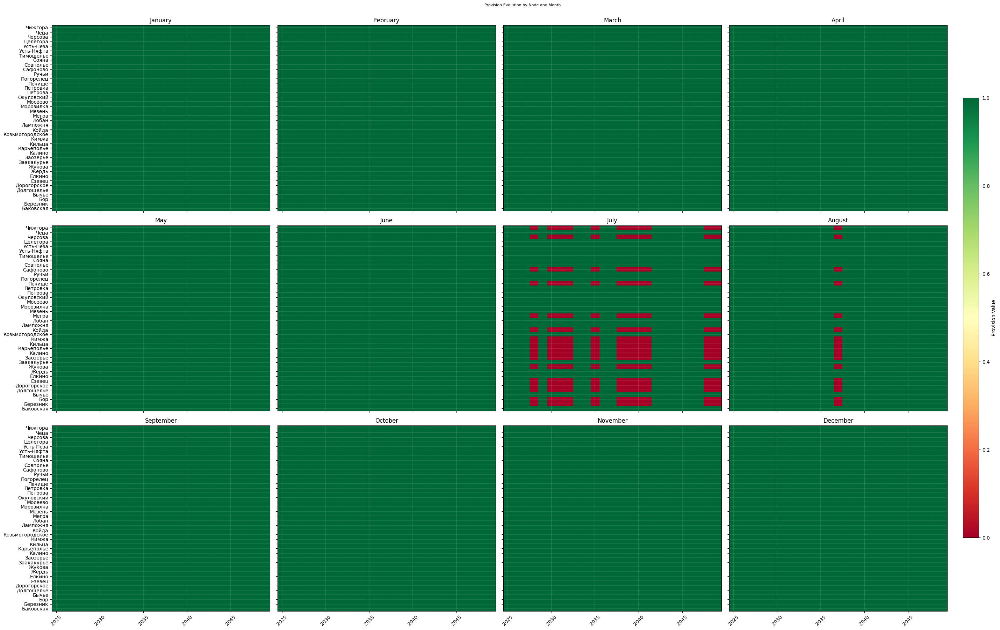

In [32]:
import matplotlib.pyplot as plt
import numpy as np


def plot_provision_evolution_by_node(results, start_year=2025, figsize=(30, 18)):
    """
    Plot provision changes over time for each node, separated by month.

    Parameters:
        results: List of DataFrames (one per timestep) with columns ['name', 'provision']
        start_year: Year of first timestep
        figsize: Size of entire plot grid
    """
    # Сбор имён нод
    node_names = sorted(
        {
            row["name"]
            for timestep in results
            for _, row in timestep.reset_index().iterrows()
        }
    )

    # Организация по месяцам
    monthly_data = {month: {name: [] for name in node_names} for month in range(12)}

    for i, timestep in enumerate(results):
        month = i % 12
        for _, row in timestep.reset_index().iterrows():
            monthly_data[month][row["name"]].append(row["provision"])

    # Сетка 3x4
    fig, axes = plt.subplots(3, 4, figsize=figsize)
    month_names = [
        "January",
        "February",
        "March",
        "April",
        "May",
        "June",
        "July",
        "August",
        "September",
        "October",
        "November",
        "December",
    ]

    for month in range(12):
        ax = axes[month // 4, month % 4]
        data = monthly_data[month]

        # Определяем число лет
        n_years = len(next(iter(data.values()), []))
        if n_years == 0:
            continue  # пропускаем пустые

        years = list(range(start_year, start_year + n_years))
        provision_matrix = np.array([data[node] for node in node_names])

        im = ax.imshow(
            provision_matrix,
            aspect="auto",
            cmap="RdYlGn",
            extent=[years[0] - 0.5, years[-1] + 0.5, -0.5, len(node_names) - 0.5],
            vmin=0,
            vmax=1,
        )

        ax.set_title(month_names[month])
        ax.set_yticks(range(len(node_names)))
        ax.set_yticklabels(node_names if month % 4 == 0 else [])
        ax.tick_params(axis="x", rotation=45)

        if month < 8:
            ax.set_xticklabels([])

        ax.grid(True, which="major", color="w", linestyle="--", linewidth=0.2)

    # Цветовая шкала
    cbar_ax = fig.add_axes([0.92, 0.15, 0.015, 0.7])
    fig.colorbar(im, cax=cbar_ax, label="Provision Value")

    fig.suptitle("Provision Evolution by Node and Month", fontsize=8, y=1)
    plt.tight_layout(rect=[0, 0, 0.91, 1])
    plt.show()


# Call the function with the results
plot_provision_evolution_by_node(net.stats.results)


In [33]:
net.stats.results[0]


,id,geometry,demand,population,capacity_hospital,demand_within,demand_without,capacity_left,closest_service,distance_to_service,assigned_to,provision
name,,,,,,,,,,,,
Баковская,1.0,"POLYGON ((289251.293 7296955.283, 289246.478 7...",4.0,33.0,0.0,4.0,0.0,0.0,Езевец,14.0,Езевец,1.0
Езевец,7.0,"POLYGON ((295266.132 7294855.028, 295261.317 7...",4.0,32.0,600.0,4.0,0.0,592.0,Езевец,0.0,Езевец,1.0
Березник,2.0,"POLYGON ((223155.568 7275140.71, 223150.752 72...",17.0,134.0,600.0,17.0,0.0,577.0,Березник,0.0,Березник,1.0
Бор,3.0,"POLYGON ((197813.422 7303955.333, 197808.607 7...",15.0,120.0,0.0,15.0,0.0,0.0,Заакакурье,2.0,Заакакурье,1.0
Заакакурье,11.0,"POLYGON ((197088.367 7305218.138, 197083.552 7...",9.0,73.0,600.0,9.0,0.0,576.0,Заакакурье,0.0,Заакакурье,1.0
Заозерье,12.0,"POLYGON ((198602.729 7297465.38, 198597.914 72...",4.0,33.0,600.0,4.0,0.0,596.0,Заозерье,0.0,Заозерье,1.0
Лампожня,21.0,"POLYGON ((194862.137 7302058.145, 194857.322 7...",9.0,68.0,600.0,9.0,0.0,591.0,Лампожня,0.0,Лампожня,1.0
Погорелец,34.0,"POLYGON ((225855.962 7268601.542, 225851.147 7...",6.0,42.0,0.0,6.0,0.0,0.0,Березник,8.0,Березник,1.0
Совполье,37.0,"POLYGON ((171869.386 7259663.664, 171864.571 7...",5.0,39.0,600.0,5.0,0.0,595.0,Совполье,0.0,Совполье,1.0


In [34]:
# pip install joypy


<Figure size 1200x800 with 0 Axes>

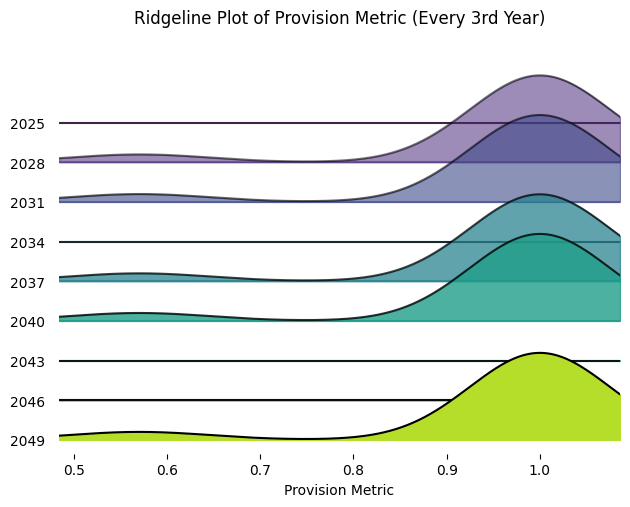

In [35]:
import joypy


# Add Year column if not already present
df_stats["Year"] = 2025 + df_stats.index // 12

# фильтр по годам, кратным 3
df_joy = df_stats[df_stats["Year"] % 3 == 0][["Year", "metric"]]
plt.figure(figsize=(12, 8))
joypy.joyplot(df_joy, by="Year", column="metric", colormap=plt.cm.viridis, fade=True)
plt.title("Ridgeline Plot of Provision Metric (Every 3rd Year)")
plt.xlabel("Provision Metric")
plt.show()


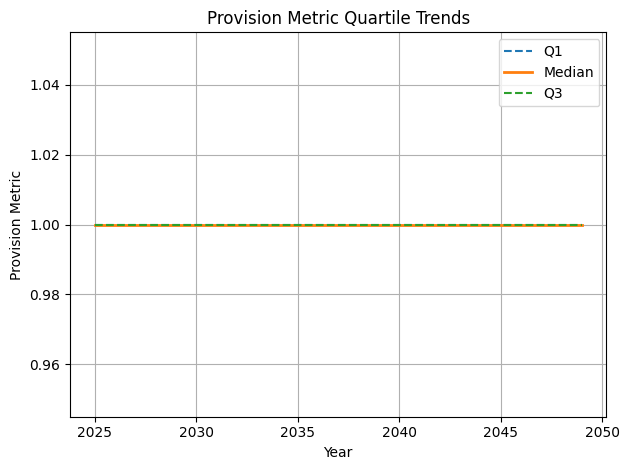

In [36]:
q_stats = df_stats.groupby("Year")["metric"].quantile([0.25, 0.5, 0.75]).unstack()
q_stats.columns = ["Q1", "Median", "Q3"]

plt.plot(q_stats.index, q_stats["Q1"], label="Q1", linestyle="--")
plt.plot(q_stats.index, q_stats["Median"], label="Median", linewidth=2)
plt.plot(q_stats.index, q_stats["Q3"], label="Q3", linestyle="--")
plt.fill_between(q_stats.index, q_stats["Q1"], q_stats["Q3"], alpha=0.2)
plt.legend()
plt.title("Provision Metric Quartile Trends")
plt.xlabel("Year")
plt.ylabel("Provision Metric")
plt.grid(True)
plt.tight_layout()
plt.show()


#### какой-то прикол с температурами в июле???

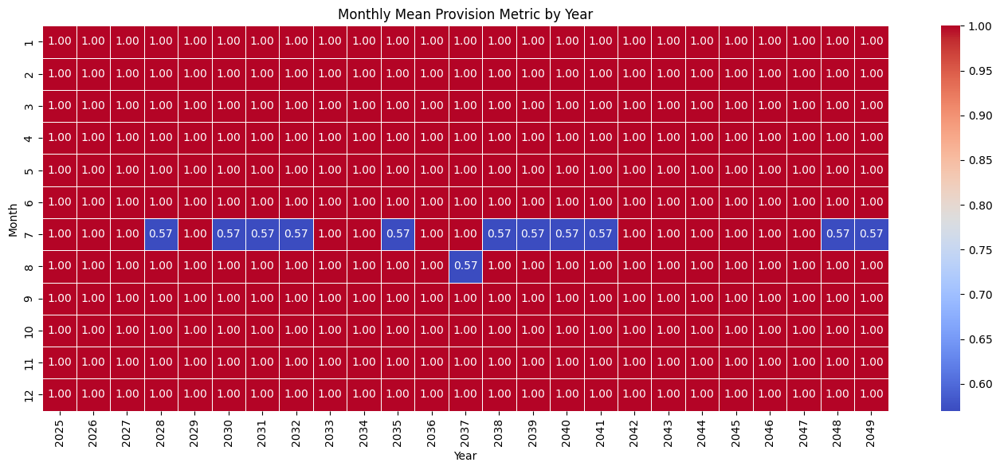

In [37]:
import seaborn as sns

# Предполагаем что индекс df_stats — это месяцы в виде `i` (0...len-1)
df_stats["Month"] = df_stats.index % 12 + 1
df_stats["Year"] = 2025 + df_stats.index // 12

# Средняя метрика по месяцам и годам
heatmap_monthly = df_stats.pivot_table(
    index="Month", columns="Year", values="metric", aggfunc="mean"
)

plt.figure(figsize=(14, 6))
sns.heatmap(heatmap_monthly, cmap="coolwarm", annot=True, fmt=".2f", linewidths=0.5)
plt.title("Monthly Mean Provision Metric by Year")
plt.xlabel("Year")
plt.ylabel("Month")
plt.tight_layout()
plt.show()


## Отрисовка графа

array([[<Axes: title={'center': 'temperature'}>]], dtype=object)

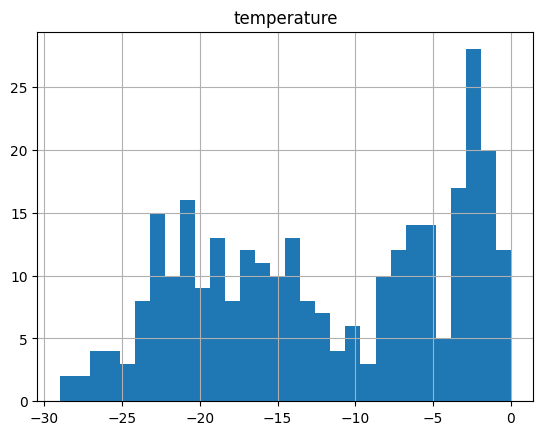

In [38]:
list(G_undirected.nodes(data=True))[25][1]["temperature"].hist(bins=30)


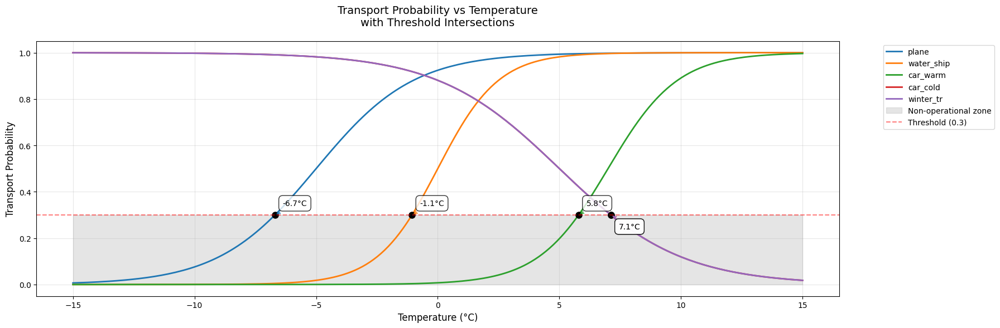

In [39]:
import matplotlib.pyplot as plt
import numpy as np

# threshold = 0.3

# Create temperature range and transport types
temps = np.linspace(-15, 15, 200)
transport_types = ["plane", "water_ship", "car_warm", "car_cold", "winter_tr"]

# Create figure with increased size
plt.figure(figsize=(18, 6))

# Plot probability curves and find threshold intersections
for t_type in transport_types:
    probs = [get_transport_probability(t_type, t) for t in temps]
    (line,) = plt.plot(temps, probs, label=t_type, linewidth=2)

    # Find intersection points with threshold
    for i in range(len(temps) - 1):
        if (probs[i] - threshold) * (probs[i + 1] - threshold) <= 0:
            # Linear interpolation to find exact intersection
            t_intersect = temps[i] + (temps[i + 1] - temps[i]) * (
                threshold - probs[i]
            ) / (probs[i + 1] - probs[i])
            plt.plot(t_intersect, threshold, "ko", markersize=8)
            plt.annotate(
                f"{t_intersect:.1f}°C",
                (t_intersect, threshold),
                xytext=(10, 10 if probs[i] < threshold else -10),
                textcoords="offset points",
                ha="left",
                va="bottom" if probs[i] < threshold else "top",
                bbox=dict(boxstyle="round,pad=0.5", fc="white", alpha=0.8),
                arrowprops=dict(arrowstyle="->", color=line.get_color()),
            )

# Add grey shading for area below threshold
plt.fill_between(
    temps, 0, threshold, color="grey", alpha=0.2, label="Non-operational zone"
)


# Add threshold line
plt.axhline(
    y=threshold, color="r", linestyle="--", alpha=0.5, label=f"Threshold ({threshold})"
)

plt.xlabel("Temperature (°C)", fontsize=12)
plt.ylabel("Transport Probability", fontsize=12)
plt.title(
    "Transport Probability vs Temperature\nwith Threshold Intersections",
    fontsize=14,
    pad=20,
)
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


In [40]:
list(net.stats.graphs[0].nodes(data=True))


[('Баковская',
  {'id': 1,
   'name': 'Баковская',
   'geometry': <POLYGON ((289251.293 7296955.283, 289246.478 7296857.265, 289232.078 729676...>,
   'x': 288251.293184194,
   'y': 7296955.282627099,
   'population': 33,
   'epsg': 32639,
   'capacity_hospital': 0,
   'temperature':      temperature
   0          -28.0
   1          -26.0
   2          -21.0
   3          -13.0
   4           -5.0
   ..           ...
   295         -4.0
   296         -3.0
   297        -11.0
   298        -16.0
   299        -18.0
   
   [300 rows x 1 columns],
   'provision': np.float64(1.0),
   'demand_within': np.float64(4.0),
   'demand_without': np.float64(0.0),
   'capacity_left': np.float64(0.0)}),
 ('Езевец',
  {'id': 7,
   'name': 'Езевец',
   'geometry': <POLYGON ((295266.132 7294855.028, 295261.317 7294757.011, 295246.917 729465...>,
   'x': 294266.13186538604,
   'y': 7294855.027711921,
   'population': 32,
   'epsg': 32639,
   'capacity_hospital': 600,
   'temperature':      temperature


### (!) Несмотря на то что связь существует, не обязательно, что она попадает в норматив доступности сервиса

/var/folders/jn/d6x3c7jd7594dtldxq22ysn80000gn/T/ipykernel_14225/2500017934.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


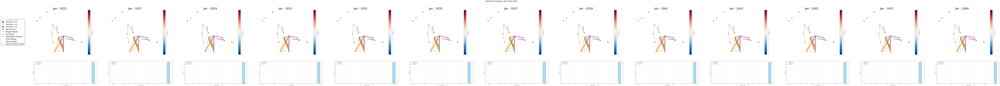

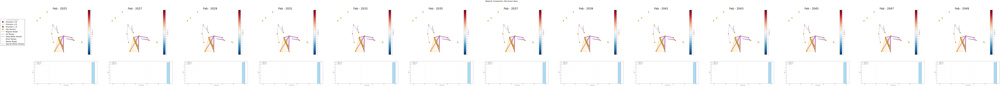

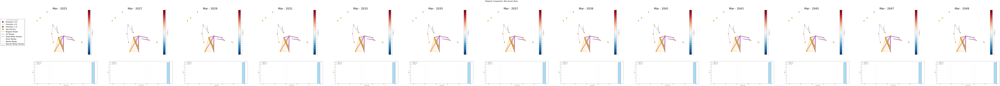

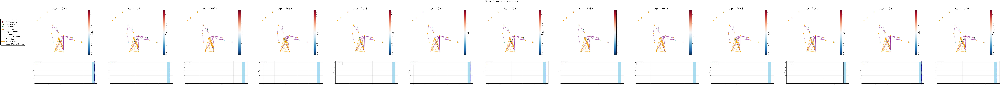

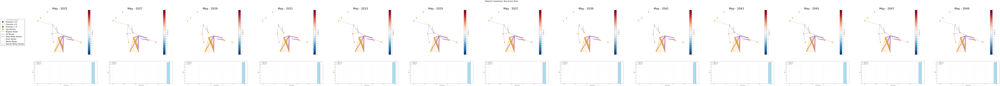

...

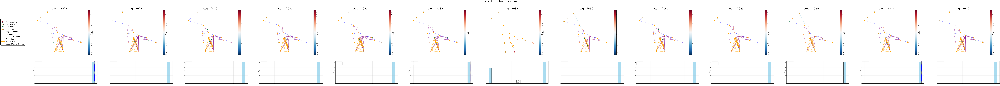

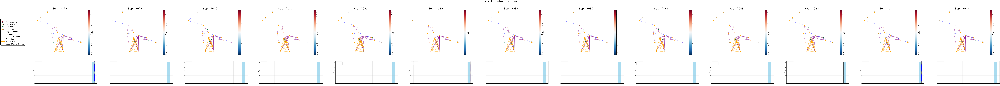

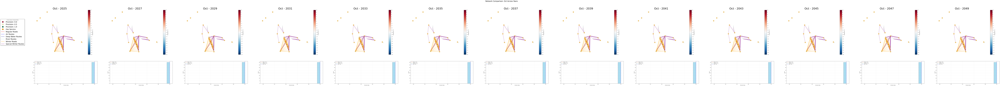

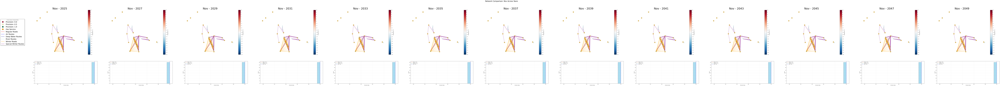

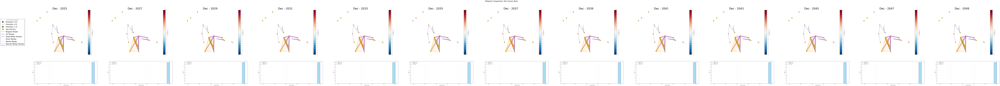

In [41]:
def plot_colored_graph_by_season_comparison(G, month_idx, graphs, stats, step):
    """Plot comparison of network states with provision distributions"""
    month_names = [
        "Jan",
        "Feb",
        "Mar",
        "Apr",
        "May",
        "Jun",
        "Jul",
        "Aug",
        "Sep",
        "Oct",
        "Nov",
        "Dec",
    ]

    # Create figure with two rows - networks on top, histograms below
    fig = plt.figure(figsize=(20 * len(graphs), 20))
    gs = plt.GridSpec(2, len(graphs), height_ratios=[2, 1], hspace=0.2)
    axes_net = [fig.add_subplot(gs[0, i]) for i in range(len(graphs))]
    axes_hist = [fig.add_subplot(gs[1, i]) for i in range(len(graphs))]

    # Get node positions
    pos = {node: (G.nodes[node]["x"], G.nodes[node]["y"]) for node in G.nodes()}

    # Fixed temperature range for consistent visualization
    vmin_temp, vmax_temp = -30, 10
    cmap_temp = plt.cm.RdBu_r
    norm_temp = plt.Normalize(vmin=vmin_temp, vmax=vmax_temp)

    # Plot each graph and its provision distribution
    for i, (year_G, stat) in enumerate(zip(graphs, stats)):
        ax_net = axes_net[i]
        ax_hist = axes_hist[i]

        # Set network plot title
        ax_net.set_title(f"{month_names[month_idx]} - {2025 + i*step}", fontsize=40)

        # Get temperatures for current timestep
        temps = [
            year_G.nodes[node]["temperature"].iloc[month_idx].item()
            for node in year_G.nodes()
        ]

        # pos = nx.spring_layout(G, seed=42)

        # 2. Применяешь искажение:
        # pos_nonlinear = nonlinear_rescale_positions(pos, alpha=0.5, beta=1.2)
        # Draw network elements
        draw_network(year_G, pos, temps, ax_net, norm_temp, cmap_temp)

        # Add temperature colorbar
        add_temperature_colorbar(vmin_temp, vmax_temp, norm_temp, cmap_temp, ax_net)

        # Plot provision distribution histogram
        plot_provision_histogram(year_G, ax_hist)

    # Add provision legend
    add_provision_legend(axes_net[0])

    # Set figure title
    fig.suptitle(
        f"Network Comparison: {month_names[month_idx]} Across Years", fontsize=25
    )

    plt.tight_layout()
    plt.show()


def draw_network(G_input, pos, temps, ax, norm, cmap):
    """Draw network elements including edges and nodes with edges colored by transport type"""

    # Define colors for different transport modes
    transport_colors = {
        "car_warm": "red",
        "plane": "blue",
        "water_ship": "darkblue",
        "water_boat": "lightblue",
        "car_cold": "orange",
        "winter_tr": "purple",
    }

    G = G_input.copy()
    G = G.to_undirected()

    # Draw circles around nodes with services
    service_nodes = [
        node
        for node in G.nodes()
        if G.nodes[node].get(f"capacity_{SERVICE_NAME}", 0) > 0
    ]

    if service_nodes:
        nx.draw_networkx_nodes(
            G,
            pos,
            nodelist=service_nodes,
            node_color="orange",  # transparent fill
            node_size=250,  # larger than regular nodes
            edgecolors="black",
            linewidths=0.2,
            ax=ax,
        )

    # Draw edges colored by transport type
    for u, v, data in G.edges(data=True):
        transport_type = data.get("label")
        if transport_type in transport_colors:
            weight = data.get("weight", 1.0)
            norm_width = (
                0.5
                + (weight / max(e[2].get("weight", 1.0) for e in G.edges(data=True)))
                * 4.5
            )

            linestyle = "--" if weight > SERVICE_RADIUS_MINUTES else "-"

            nx.draw_networkx_edges(
                G,
                pos,
                edgelist=[(u, v)],
                edge_color=transport_colors[transport_type],
                width=norm_width,
                alpha=0.5,
                ax=ax,
                style=linestyle,
            )

    # Draw temperature nodes (larger)
    nodes = nx.draw_networkx_nodes(
        G,
        pos,
        node_color=temps,
        cmap=cmap,
        node_size=60,
        vmin=norm.vmin,
        vmax=norm.vmax,
        ax=ax,
    )

    # Draw provision nodes (smaller)
    nx.draw_networkx_nodes(
        G,
        pos,
        node_color=[G.nodes[node].get("provision", 0) for node in G.nodes()],
        cmap=plt.cm.RdYlGn,
        vmin=0,
        vmax=1,
        node_size=20,
        edgecolors="white",
        linewidths=0.8,
        ax=ax,
    )

    ax.set_axis_off()


def add_temperature_colorbar(vmin, vmax, norm, cmap, ax):
    """Add temperature colorbar with appropriate ticks"""
    sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
    cbar = plt.colorbar(sm, ax=ax, label="Temperature (°C)")
    tick_spacing = 2
    cbar.set_ticks(np.arange(vmin, vmax + 1, tick_spacing))


def plot_provision_histogram(G, ax):
    """Plot histogram of provision values with statistics"""
    provision_values = [G.nodes[node].get("provision", 0) for node in G.nodes()]
    stats_dict = {
        "mean": np.mean(provision_values),
        "median": np.median(provision_values),
        "min": np.min(provision_values),
    }

    # Plot histogram
    ax.hist(
        provision_values,
        bins=20,
        range=(0, 1),
        color="skyblue",
        edgecolor="black",
        alpha=0.7,
    )

    # Add statistic lines
    colors = {"mean": "red", "median": "green", "min": "blue"}
    for stat_name, value in stats_dict.items():
        ax.axvline(
            x=value,
            color=colors[stat_name],
            linestyle="--",
            label=f"{stat_name.capitalize()}: {value:.2f}",
        )

    ax.set_xlabel("Provision Value")
    ax.set_ylabel("Count")
    ax.legend()
    ax.grid(True, alpha=0.3)


def add_provision_legend(ax):
    """Add provision value, transport mode, and service node legends to the left side of the plot"""
    # Provision legend elements
    provision_elements = [
        plt.Line2D(
            [0],
            [0],
            marker="o",
            color="none",
            markerfacecolor=plt.cm.RdYlGn(val),
            label=f"Provision: {val:.1f}",
            markersize=20,
        )
        for val in [0.0, 0.5, 1.0]
    ]

    # Service node indicator
    service_element = [
        plt.Line2D(
            [0],
            [0],
            marker="o",
            color="none",
            markerfacecolor="orange",
            label="Has Service",
            markersize=20,
        )
    ]

    # Transport mode legend elements
    transport_colors = {
        "Regular Roads": "red",
        "Air Routes": "blue",
        "Deep Water Routes": "darkblue",
        "River Routes": "lightblue",
        "Winter Roads": "orange",
        "Special Winter Routes": "purple",
    }

    transport_elements = [
        plt.Line2D([0], [0], color=color, label=mode, linewidth=2)
        for mode, color in transport_colors.items()
    ]

    # Create a single legend with all elements
    all_elements = provision_elements + service_element + transport_elements

    ax.legend(
        handles=all_elements,
        bbox_to_anchor=(-0.2, 0.5),
        loc="center right",
        borderaxespad=0,
        fontsize=25,
        title="Provision Values & Transport Modes",
        frameon=True,
        edgecolor="black",
        fancybox=True,
        shadow=True,
    )


def plot_network_evolution_by_month(net, step):
    """Plot network evolution for each month"""
    graphs_by_month = {month: [] for month in range(12)}
    stats_by_month = {month: [] for month in range(12)}

    # Organize graphs and stats by month
    for year in range(0, len(net.stats.graphs) // 12, step):
        start_idx = year * 12
        for month in range(12):
            idx = start_idx + month
            if idx < len(net.stats.graphs):
                graphs_by_month[month].append(net.stats.graphs[idx])
                stats_by_month[month].append(net.stats.records["metric"].iloc[idx])

    # Plot each month's evolution
    for month_idx in range(12):
        if graphs_by_month[month_idx]:
            plot_colored_graph_by_season_comparison(
                G_undirected,
                month_idx,
                graphs_by_month[month_idx],
                stats_by_month[month_idx],
                step=step,
            )


# Call the visualization
plot_network_evolution_by_month(net, step=2)


# Выводы (вопросы Любы)

### 1.  prediction of network node attributes (provision type etc.) given structural network node properties (betweenness measures)

### 2.  we can represent the network of connectivity between cities  as multilayed network (structuring it by node attributes or by link types), this representation is an alternative  representation of seasonal  data as network structures

### 3. Main (hub "опорные") cities selection based on the connectivity types. Depending on the connectivity type we can get separate main hub cities.

### 4. Characterisation of critical moments (given structural and node attribute properties). How to distinguish them using network analysis (solely) ?

# some old things

In [42]:
1 / 0


ZeroDivisionError: division by zero

In [ ]:
# --------------------------------------------------------
1 / 0


In [ ]:
G_undirected.edges(data=True)


In [ ]:
nx.to_pandas_adjacency(G_undirected)


In [ ]:
G_undirected[24][5]


In [ ]:
# Create a list of dictionaries to store node pairs and their connection details
node_pairs = []
pair_connections = {}

for u, v, data in G_undirected.edges(data=True):
    pair = tuple(sorted([u, v]))

    if pair not in pair_connections:
        pair_connections[pair] = []

    # Store the connection details (transport mode and weight)
    connection = {"mode": data.get("label"), "weight": data.get("weight")}

    # Only add if this exact combination doesn't exist yet
    if connection not in pair_connections[pair]:
        pair_connections[pair].append(connection)

# Convert to list format if needed
node_pairs = [(pair, connections) for pair, connections in pair_connections.items()]

# Example of how to print the results:
for pair, connections in node_pairs:
    print(f"\nConnection between {pair[0]} and {pair[1]}:")
    for conn in connections:
        print(f"  - Mode: {conn['mode']}, Weight: {conn['weight']}")


In [ ]:
def plot_node_pair_connections(G, node1, node2):
    """
    Plot all transport connections between two specific nodes, including duplicates with different weights
    """
    plt.figure(figsize=(12, 8))

    # Define colors for different transport modes
    transport_colors = {
        "car_warm": "red",
        "plane": "blue",
        "water_ship": "darkblue",
        "water_boat": "lightblue",
        "car_cold": "orange",
        "winter_tr": "purple",
    }

    # Get node positions
    pos = {
        node: (G.nodes[node]["x"] * 1.5, G.nodes[node]["y"] * 1.5) for node in G.nodes()
    }

    # Draw only the two nodes of interest
    nx.draw_networkx_nodes(
        G, pos, nodelist=[node1, node2], node_size=1000, node_color="lightgray"
    )
    nx.draw_networkx_labels(G, pos, labels={node1: node1, node2: node2}, font_size=14)

    # Find and group edges by their properties
    edge_groups = {}
    for u, v, data in G.edges(data=True):
        if (u == node1 and v == node2) or (u == node2 and v == node1):
            key = (data.get("label"), data.get("weight"))
            if key not in edge_groups:
                edge_groups[key] = []
            edge_groups[key].append((u, v, data))

    # Draw edges with different curves
    for idx, ((mode, weight), edges) in enumerate(edge_groups.items()):
        if mode in transport_colors:
            # Calculate curve offset based on index
            rad = 0.2 + (idx * 0.15)  # Increased spacing between curves

            # Scale width by weight
            width = weight * 3 if weight else 3  # Increased width scaling

            # Draw edge with curved path
            for u, v, data in edges:
                nx.draw_networkx_edges(
                    G,
                    pos,
                    edgelist=[(u, v)],
                    edge_color=transport_colors[mode],
                    width=width,
                    alpha=0.7,
                    label=f"{mode} ({weight:.1f})",
                    connectionstyle=f"arc3, rad={rad}",
                )

    plt.title(f"Transport Connections between {node1} and {node2}", pad=20)
    plt.legend(
        loc="center left",
        bbox_to_anchor=(1, 0.5),
        fontsize=12,
        title="Transport Modes (with weights)",
        title_fontsize=14,
    )
    plt.axis("off")
    plt.tight_layout()
    plt.show()


# Find unique node pairs
node_pairs = []
for u, v in G_undirected.edges():
    pair = tuple(sorted([u, v]))
    if pair not in node_pairs:
        node_pairs.append(pair)

# Plot connections for each node pair
for node1, node2 in node_pairs:
    plot_node_pair_connections(G_undirected, node1, node2)


In [ ]:
def plot_colored_graph_by_season_comparison(G, month_idx, graphs, stats):
    """
    Plot comparison of network states for a given month across all years
    """
    fig, axes = plt.subplots(1, len(graphs), figsize=(4 * len(graphs), 5))

    # Handle case of 1 subplot
    if len(graphs) == 1:
        axes = [axes]

    # Get node positions from original graph
    pos = {node: (G.nodes[node]["x"], G.nodes[node]["y"]) for node in G.nodes()}

    # Color mapping for seasons
    season_colors = {
        "winter": "lightblue",
        "summer": "salmon",
        "midseason": "lightgreen",
    }

    month_names = [
        "Jan",
        "Feb",
        "Mar",
        "Apr",
        "May",
        "Jun",
        "Jul",
        "Aug",
        "Sep",
        "Oct",
        "Nov",
        "Dec",
    ]

    for i, (year_G, stat) in enumerate(zip(graphs, stats)):
        ax = axes[i]
        ax.set_title(f"{month_names[month_idx]} - {2025 + i*5}", fontsize=18)

        # Get node colors for current timestep
        node_colors = [
            season_colors[year_G.nodes[node]["season"].iloc[month_idx].item()]
            for node in year_G.nodes()
        ]

        # Detect edge changes vs previous year
        if i > 0:
            prev_edges = set(graphs[i - 1].edges())
            curr_edges = set(year_G.edges())

            added = curr_edges - prev_edges
            removed = prev_edges - curr_edges
            unchanged = curr_edges & prev_edges
        else:
            added = removed = set()
            unchanged = set(year_G.edges())

        # Draw edges with different styles based on their status
        nx.draw_networkx_edges(
            year_G, pos, edgelist=list(unchanged), edge_color="gray", width=1, ax=ax
        )
        nx.draw_networkx_edges(
            year_G,
            pos,
            edgelist=list(added),
            edge_color="green",
            width=3,
            style="solid",
            ax=ax,
        )
        if i > 0:
            nx.draw_networkx_edges(
                year_G,
                pos,
                edgelist=list(removed),
                edge_color="red",
                width=1.5,
                style="dashed",
                ax=ax,
            )

        # Draw nodes with seasonal colors
        nx.draw_networkx_nodes(year_G, pos, node_color=node_colors, node_size=50, ax=ax)
        nx.draw_networkx_labels(year_G, pos, font_size=0, ax=ax)

        # Add connectivity metric
        stat_text = f"\n\n{round(stat,2)}"
        ax.text(
            0.45,
            0.01,
            stat_text,
            transform=ax.transAxes,
            fontsize=18,
            verticalalignment="bottom",
            bbox=dict(facecolor="white", alpha=0.7, edgecolor="none"),
        )

        ax.set_axis_off()

    # Add legend to first subplot
    legend_elements = []
    # Season legend
    for season, color in season_colors.items():
        legend_elements.append(
            plt.Line2D(
                [0],
                [0],
                marker="o",
                color="w",
                markerfacecolor=color,
                label=season,
                markersize=10,
            )
        )
    # Edge type legend
    legend_elements.extend(
        [
            plt.Line2D([0], [0], color="gray", label="Unchanged"),
            plt.Line2D([0], [0], color="green", label="Added"),
            plt.Line2D([0], [0], color="red", linestyle="--", label="Removed"),
        ]
    )
    # Change this line to move legend outside:
    axes[0].legend(
        handles=legend_elements,
        bbox_to_anchor=(-0.05, 0.65),  # Move legend left and slightly up
        loc="center right",
        borderaxespad=0,
        frameon=True,
        fontsize=12,
    )

    fig.suptitle(
        f"Network Comparison: {month_names[month_idx]} Across Years\n\n", fontsize=18
    )
    plt.tight_layout()
    plt.show()


# Organize the visualization by month
def plot_network_evolution_by_month(net):
    graphs_by_month = [[] for _ in range(12)]

    stats_by_month = [[] for _ in range(12)]

    for i, G in enumerate(net.stats.graphs):
        month_index = i % 12
        graphs_by_month[month_index].append(G)
        stats_by_month[month_index].append(net.stats.records["metric"].iloc[i])

    # Plot each month's evolution
    for month_idx in range(12):
        plot_colored_graph_by_season_comparison(
            G_undirected,
            month_idx,
            graphs_by_month[month_idx],
            stats_by_month[month_idx],
        )


# Call the visualization
plot_network_evolution_by_month(net)


In [ ]:
def plot_colored_graph_by_season(G, timestep):
    """
    Plot graph with nodes colored by their season at given timestep
    """
    plt.figure(figsize=(12, 8))

    # Color mapping for seasons
    season_colors = {
        "winter": "lightblue",
        "summer": "salmon",
        "midseason": "lightgreen",
    }

    # Get node positions from latitude/longitude
    pos = {node: (G.nodes[node]["x"], G.nodes[node]["y"]) for node in G.nodes()}

    # Get seasons for each node at current timestep - use .item() to get single value
    node_colors = [
        season_colors[G.nodes[node]["season"].iloc[timestep].item()]
        for node in G.nodes()
    ]

    # Draw edges
    nx.draw_networkx_edges(G, pos, edge_color="gray", width=1, alpha=0.5)

    # Draw nodes
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=500)

    # Add labels
    nx.draw_networkx_labels(G, pos, font_size=8)

    # Add legend
    legend_elements = [
        plt.Line2D(
            [0],
            [0],
            marker="o",
            color="w",
            markerfacecolor=color,
            label=season,
            markersize=10,
        )
        for season, color in season_colors.items()
    ]
    plt.legend(handles=legend_elements, loc="upper left")

    plt.title(f"Network State at Timestep {timestep}")
    plt.axis("off")
    plt.tight_layout()
    plt.show()


# Create an animation showing how seasons change over time
def plot_seasonal_evolution(G, num_timesteps=12):
    """
    Plot sequence of graphs showing seasonal changes
    num_timesteps: number of time steps to show (default: one year)
    """
    for t in range(num_timesteps):
        plot_colored_graph_by_season(G, t)
        plt.close()


# Call the function to visualize seasonal changes over one year
plot_seasonal_evolution(G_undirected)


## Графики изменения температур(ы)

In [ ]:
import matplotlib.pyplot as plt
import math

# Assume all nodes have the same length of temperature data
some_node = next(iter(G_undirected.nodes()))
total_timesteps = len(G_undirected.nodes[some_node]["temperature"])
segment_size = 12
num_segments = math.ceil(total_timesteps / segment_size)

for seg in range(num_segments):
    plt.figure(figsize=(10, 6))
    start = seg * segment_size
    end = (seg + 1) * segment_size

    for i in G_undirected.nodes():
        temp_series = G_undirected.nodes[i]["temperature"][start:end]
        plt.plot(range(start, end), temp_series, label=f"Node {i}")

    # Add horizontal lines for seasonal thresholds
    plt.axhline(
        -10, color="blue", linestyle="--", linewidth=1, label="Winter threshold (-10°C)"
    )
    plt.axhline(
        5, color="red", linestyle="--", linewidth=1, label="Summer threshold (5°C)"
    )

    plt.xlabel("Time")
    plt.ylabel("Temperature")
    plt.title(f"Temperatures for Time {start}–{end - 1}")
    plt.legend(loc="upper right", fontsize="small", ncol=2)
    plt.tight_layout()
    plt.show()


In [ ]:
import matplotlib.pyplot as plt
import math

# Optional: define a color map for seasons
segment_size = 12

for node in G_undirected.nodes():
    temperature = G_undirected.nodes[node]["temperature"]
    total_timesteps = len(temperature)
    num_segments = math.ceil(total_timesteps / segment_size)

    plt.figure(figsize=(10, 6))

    for seg in range(num_segments):
        start = seg * segment_size
        end = min((seg + 1) * segment_size, total_timesteps)
        segment = temperature[start:end].reset_index(drop=True)

        # Shift x-axis to actual time positions
        plt.plot(segment, label=f"Time {start}–{end-1}")

    # Add horizontal lines for seasonal thresholds
    plt.axhline(
        -10, color="blue", linestyle="--", linewidth=1, label="Winter threshold (-10°C)"
    )
    plt.axhline(
        5, color="red", linestyle="--", linewidth=1, label="Summer threshold (5°C)"
    )

    plt.xlabel("Time")
    plt.ylabel("Temperature")
    plt.title(f"Temperature Segments for Node {node}")
    plt.legend(loc="upper right", fontsize="small", ncol=2)
    plt.tight_layout()
    plt.show()


### Мои комменты и мысли по всему происходящему

In [ ]:
"""DONE

NOTE: у каждого города следует указать температуру
тк формально в один момент времени в разных городах могут быть разные сезоны --
-- а это значит что для существования линка нужно чтобы в двух городах был
подходящий для линка сезон
"""


In [ ]:
"""DONE [ну кроме последнего пункта но то такое]

короче NOTE: Для каждого сервиса -- разный граф (!!!)
- не только в формате где сервисы
- но и в формате что для школы условно на самолете нет смысла мб смотреть
а для госпиталя есть
"""


In [ ]:
"""DONE

добавить FIXME:
- посмотреть есть ли что-то на стыке статей по типу:
а) поиск кратчайшего пути на вот этих вероятностных сетях
б) что то про ебучие бензовозы (всм агентный подход для покрытия деманда) + под изменением внешней среды


-- NOTE: нихуя там короче нет чисто мб 1-2 статьи в этом направлении но и то специфичные
"""


In [ ]:
"""DONE

TODO: посмотреть шо там вероятностные сети вообще существует((( плак-плак
+ отдельно путь на них

-- NOTE: нихуя там короче нет чисто мб 1-2 статьи в этом направлении но и то специфичные
"""


In [ ]:
"""DONE

короче NOTE: Хочется как будто иметь отдельные сущности для каждого вида транспорта,
чтобы задавать параметры отдельно чтоль

-- что-то уже и хз
"""


In [ ]:
"""DONE

короче NOTE

чтобы считать для разных территоий (всм Арктика / Африка итп) мне нужно глобально:

-  некий объект внешней среды который имеет значения которые влиюят на мой граф
тут что-то про то что если это гдф то ну я как-то пересекаю это с графом
если нет то мне нужен некий маппинг между моим объектом внешней среды и графом

- этот объект глобально изменяет свои параметры со временем.
Считаем что это а) какая-то периодическая функция б) некий глобальный тренд
Может меняться как равнимерно так и <<по участкам>> ака неравномерно влиять на точки

- нормально зайдет если у меня граф дефолтно или с геометриями или нет (!?)
"""


In [ ]:
"""DONE

короче про граф связей

- я в итоге работаю с вероятностями которые растут или падают от сезона
- скорости как будто тогда нужны для базового расчета обеспеченности (ну доступности)
и тогда я получается имею отдельный какой-то мэтчинг между:
а) ребром & классом ребра & типом ребра и внешней средой
б) то есть для каждого ребра-типа-класса своё правило как оно реагирует на внешнюю среду

и тут уже путь считается как бы сначала по вероятностям каждого ребра в графе:
- нужен некий трэшхолд по которому я говорю что всё нет допустим средняя или минимальная вероятность существования ребра
- и от этого собсно я понимаю есть ли (существует ли) у меня * конкретный * путь или нет
"""


In [ ]:
"""DONT NEED ANYMORE
Короче вот класс и пример как темпа меняется (ну всм растет) в год
"""

# from copy import deepcopy


# class SeasonByTemperature:
#     def __init__(self, func=None, temp_raise_year=None, step_year=0, total_increment=0):
#         self.func = deepcopy(func)
#         self.temp_raise_year = temp_raise_year
#         self.step_year = step_year
#         self.total_increment = total_increment

#     def incement_temp(self, new_increment: int | None = None):
#         if new_increment:
#             self.temp_raise_year = new_increment
#         if self.temp_raise_year and self.func.any():
#             self.func += self.temp_raise_year
#             self.step_year += 1
#             self.total_increment += self.temp_raise_year
#         else:
#             print("No temperature function or raise year defined.")

#     def get_monthly_temp(self, month_idx: int = None):
#         if month_idx and month_idx in range(1, len(self.func) + 1):
#             return round(self.func[month_idx - 1], 1)
#         else:
#             print("Invalid month index. Must be between 1 and 12.")

#     def get_season_by_temperature(temp):
#         if temp < -10:
#             return "winter"
#         elif temp > 5:
#             return "summer"
#         else:
#             return "midseason"

#     def get_season_by_month(self, month_idx: int = None):
#         return self.get_season_by_temperature(self.get_monthly_temp(month_idx))

#     def __repr__(self):
#         return f"<Year: {self.step_year}, Temp: {self.total_increment:.2f}>"


# temp_env = SeasonByTemperature(
#     func=periodic_temp_func,
#     temp_raise_year=0.5,
# )

# for i in range(12):
#     temp_env.incement_temp()

# print(temp_env, temp_env.get_monthly_temp(12))
# pprint(f"Temperature function: {temp_env.func}")
# pprint(f"Total temperature increment: {temp_env.total_increment}")
# pprint(f"Step year: {temp_env.step_year}")


In [ ]:
"""НЕ УВЕРЕН ЧТО ЭТО НУЖНО
Но это без каких-либо FACILITIES.

Можно будет добавить потом но хз пока не надо
"""

# class CityNode:
#     def __init__(self, name):
#         self.name = name
#         self.geometry = None
#         self.temperature = None
#         self.season = None

#     def __repr__(self):
#         return f"CityNode(name={self.name})"
